In [33]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import zscore
from sklearn import preprocessing
from sklearn.metrics import r2_score
from sklearn.preprocessing import QuantileTransformer
from sklearn.preprocessing import LabelEncoder

In [34]:
vg_sales=pd.read_csv(r"C:\Users\BAPS\Desktop\Python\Datasets\vgsales.csv")

In [35]:
vg_sales_o=vg_sales.copy()

In [36]:
vg_sales

,Rank,Name,Platform,Year,Genre,Publisher,NA_Sales,EU_Sales,JP_Sales,Other_Sales,Global_Sales
0,1,Wii Sports,Wii,2006.0,Sports,Nintendo,41.49,29.02,3.77,8.46,82.74
1,2,Super Mario Bros.,NES,1985.0,Platform,Nintendo,29.08,3.58,6.81,0.77,40.24
2,3,Mario Kart Wii,Wii,2008.0,Racing,Nintendo,15.85,12.88,3.79,3.31,35.82
3,4,Wii Sports Resort,Wii,2009.0,Sports,Nintendo,15.75,11.01,3.28,2.96,33.00
4,5,Pokemon Red/Pokemon Blue,GB,1996.0,Role-Playing,Nintendo,11.27,8.89,10.22,1.00,31.37
...,...,...,...,...,...,...,...,...,...,...,...
16593,16596,Woody Woodpecker in Crazy Castle 5,GBA,2002.0,Platform,Kemco,0.01,0.00,0.00,0.00,0.01
16594,16597,Men in Black II: Alien Escape,GC,2003.0,Shooter,Infogrames,0.01,0.00,0.00,0.00,0.01
16595,16598,SCORE International Baja 1000: The Official Game,PS2,2008.0,Racing,Activision,0.00,0.00,0.00,0.00,0.01
16596,16599,Know How 2,DS,2010.0,Puzzle,7G//AMES,0.00,0.01,0.00,0.00,0.01


In [37]:
vg_sales.info()
# OBSERVATION -> There are 16598 records and 11 columns
# Columns ->['Name', 'Platform', 'Genre', 'Publisher'] are object type 
# Column -> ["Rank"] is int64 
# Columns -> ['Year', 'NA_Sales', 'EU_Sales', 'JP_Sales', 'Other_Sales','Global_Sales'] are float64

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 16598 entries, 0 to 16597
Data columns (total 11 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   Rank          16598 non-null  int64  
 1   Name          16598 non-null  object 
 2   Platform      16598 non-null  object 
 3   Year          16327 non-null  float64
 4   Genre         16598 non-null  object 
 5   Publisher     16540 non-null  object 
 6   NA_Sales      16598 non-null  float64
 7   EU_Sales      16598 non-null  float64
 8   JP_Sales      16598 non-null  float64
 9   Other_Sales   16598 non-null  float64
 10  Global_Sales  16598 non-null  float64
dtypes: float64(6), int64(1), object(4)
memory usage: 1.4+ MB


In [38]:
vg_sales.select_dtypes("object").columns

Index(['Name', 'Platform', 'Genre', 'Publisher'], dtype='object')

In [39]:
(vg_sales.isnull().sum())/len(vg_sales)*100
# Columns ["Year","Publisher "] has some missing values
# Since the missing values are less than 25% percent we can handle missing values.

Rank            0.000000
Name            0.000000
Platform        0.000000
Year            1.632727
Genre           0.000000
Publisher       0.349440
NA_Sales        0.000000
EU_Sales        0.000000
JP_Sales        0.000000
Other_Sales     0.000000
Global_Sales    0.000000
dtype: float64

In [40]:
len(vg_sales['Name'].unique())

11493

In [41]:
len(vg_sales['Publisher'].unique())

579

In [42]:
len(vg_sales["Genre"].unique())

12

In [43]:
len(vg_sales["Platform"].unique())

31

In [44]:
vg_sales.describe().T

,count,mean,std,min,25%,50%,75%,max
Rank,16598.0,8300.605254,4791.853933,1.00,4151.25,8300.50,12449.75,16600.00
Year,16327.0,2006.406443,5.828981,1980.00,2003.00,2007.00,2010.00,2020.00
NA_Sales,16598.0,0.264667,0.816683,0.00,0.00,0.08,0.24,41.49
EU_Sales,16598.0,0.146652,0.505351,0.00,0.00,0.02,0.11,29.02
JP_Sales,16598.0,0.077782,0.309291,0.00,0.00,0.00,0.04,10.22
Other_Sales,16598.0,0.048063,0.188588,0.00,0.00,0.01,0.04,10.57
Global_Sales,16598.0,0.537441,1.555028,0.01,0.06,0.17,0.47,82.74


### Univariant Analysis

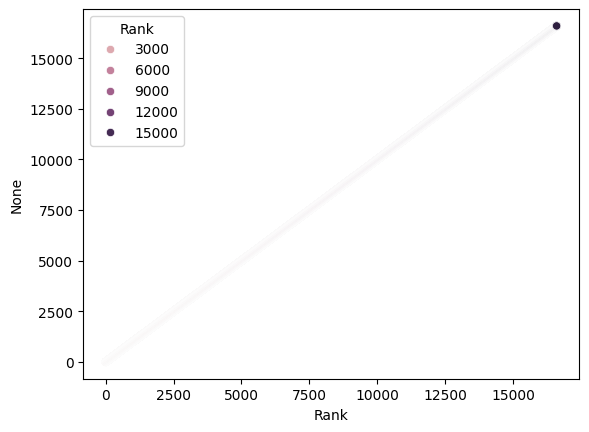

C:\Users\BAPS\AppData\Roaming\Python\Python311\site-packages\IPython\core\pylabtools.py:170: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


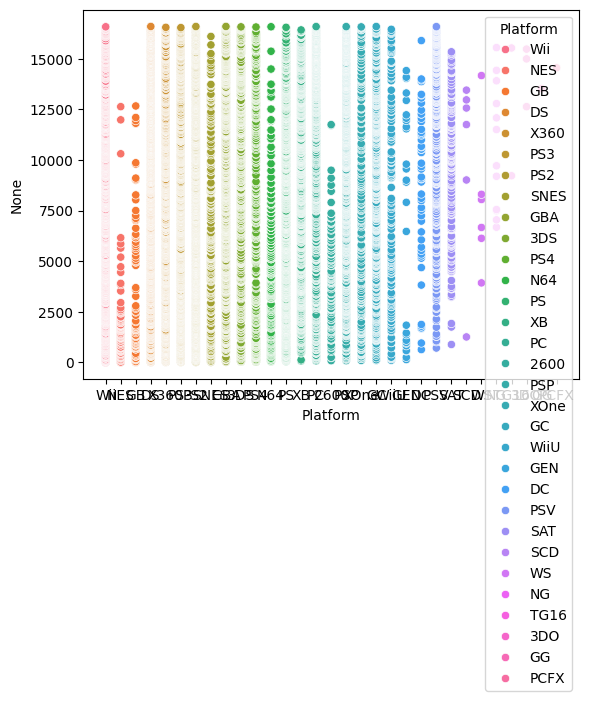

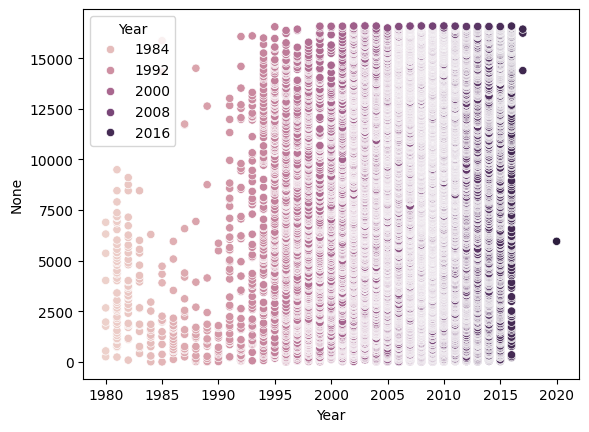

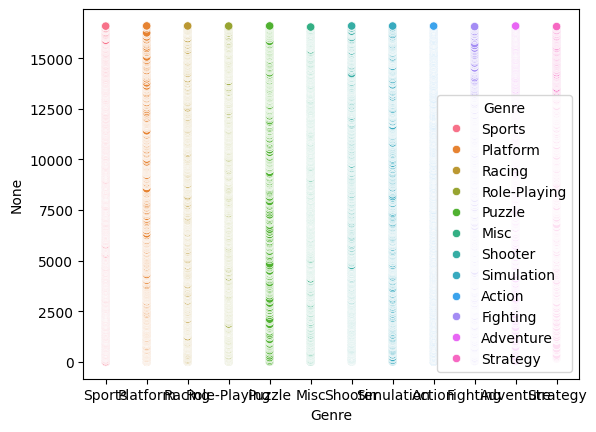

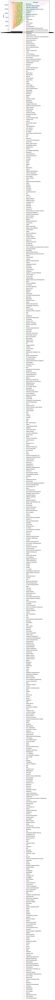

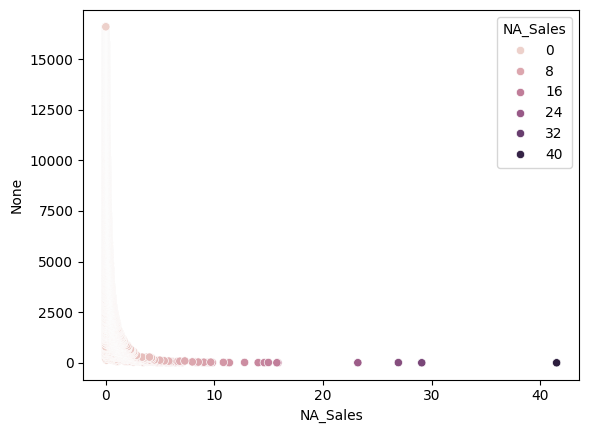

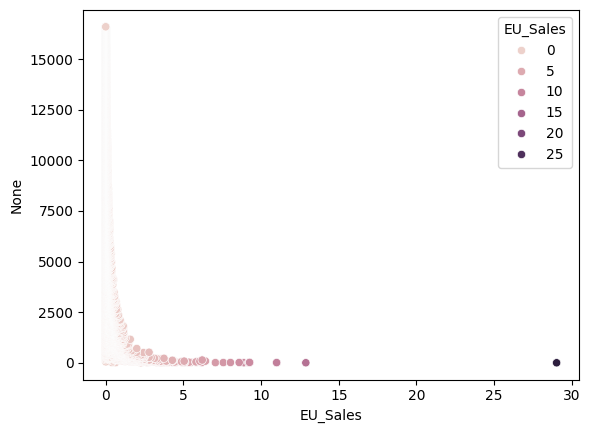

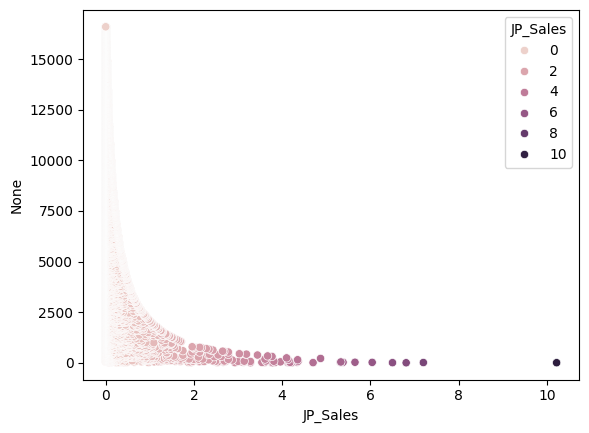

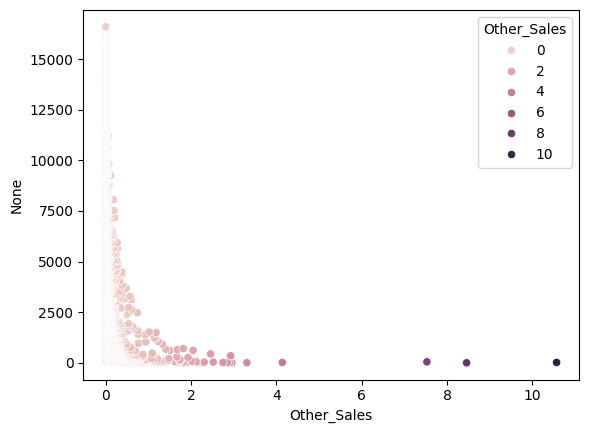

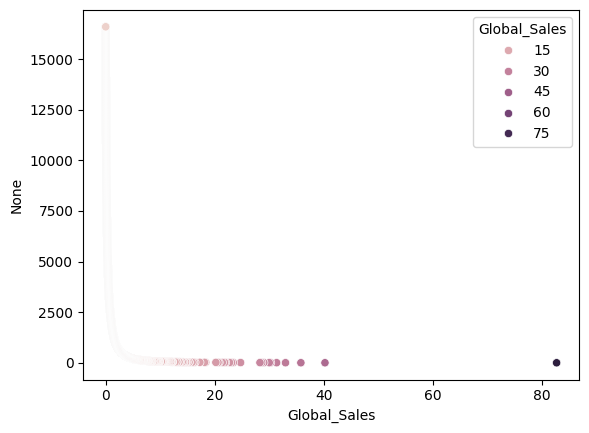

In [45]:
for col in vg_sales.columns:
    plt.figure()
    sns.scatterplot(x=vg_sales[col],data=vg_sales,y=vg_sales.index,hue=col)

In [46]:
encoder=LabelEncoder()

In [47]:
# Frequency encoder
vg_sales['Platform'] = vg_sales['Platform'].map(vg_sales['Platform'].value_counts()) 

In [48]:
# Frequency encoder
vg_sales["Publisher"] = vg_sales["Publisher"].map(vg_sales["Publisher"].value_counts()) 

In [49]:
vg_sales["Genre"]=encoder.fit_transform(vg_sales["Genre"])

In [51]:
# vg_sales.drop(["platform_encoded"],axis=1,inplace=True)

In [52]:
vg_sales

,Rank,Name,Platform,Year,Genre,Publisher,NA_Sales,EU_Sales,JP_Sales,Other_Sales,Global_Sales
0,1,Wii Sports,1325,2006.0,10,703.0,41.49,29.02,3.77,8.46,82.74
1,2,Super Mario Bros.,98,1985.0,4,703.0,29.08,3.58,6.81,0.77,40.24
2,3,Mario Kart Wii,1325,2008.0,6,703.0,15.85,12.88,3.79,3.31,35.82
3,4,Wii Sports Resort,1325,2009.0,10,703.0,15.75,11.01,3.28,2.96,33.00
4,5,Pokemon Red/Pokemon Blue,98,1996.0,7,703.0,11.27,8.89,10.22,1.00,31.37
...,...,...,...,...,...,...,...,...,...,...,...
16593,16596,Woody Woodpecker in Crazy Castle 5,822,2002.0,4,21.0,0.01,0.00,0.00,0.00,0.01
16594,16597,Men in Black II: Alien Escape,556,2003.0,8,62.0,0.01,0.00,0.00,0.00,0.01
16595,16598,SCORE International Baja 1000: The Official Game,2161,2008.0,6,975.0,0.00,0.00,0.00,0.00,0.01
16596,16599,Know How 2,2163,2010.0,5,4.0,0.00,0.01,0.00,0.00,0.01
